<a href="https://colab.research.google.com/github/RISHAD-prog/CVPR--C-SPRING-22-23-/blob/main/face_mask_detection_usingCNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install kaggle

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d omkargurav/face-mask-dataset

 99% 161M/163M [00:01<00:00, 155MB/s]
100% 163M/163M [00:01<00:00, 141MB/s]


In [ ]:
from zipfile import ZipFile
dataset = '/content/face-mask-dataset.zip'

with ZipFile(dataset,'r') as zip:
  zip.extractall()
  print('The dataset is extracted')

The dataset is extracted


In [ ]:
!ls

data  face-mask-dataset.zip  kaggle.json  sample_data


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image  as mpimg
import cv2
from google.colab.patches import cv2_imshow
from PIL import Image
from sklearn.model_selection import train_test_split

In [ ]:
with_mask=os.listdir('/content/data/with_mask')
print(with_mask[0:5])
print(with_mask[-5:])

['with_mask_1600.jpg', 'with_mask_1103.jpg', 'with_mask_604.jpg', 'with_mask_1823.jpg', 'with_mask_586.jpg']
['with_mask_958.jpg', 'with_mask_3218.jpg', 'with_mask_3251.jpg', 'with_mask_3425.jpg', 'with_mask_3236.jpg']


In [ ]:
without_mask=os.listdir('/content/data/without_mask')
print(without_mask[0:5])
print(without_mask[-5:])

['without_mask_3383.jpg', 'without_mask_576.jpg', 'without_mask_293.jpg', 'without_mask_350.jpg', 'without_mask_3452.jpg']
['without_mask_420.jpg', 'without_mask_2630.jpg', 'without_mask_523.jpg', 'without_mask_2440.jpg', 'without_mask_2602.jpg']


In [ ]:
print("length of with mask image: ", len(with_mask))
print("length of with mask image: ", len(without_mask))

length of with mask image:  3725
length of with mask image:  3828


**Creating labels for the datasets**

In [ ]:
with_mask_labels= [1]*len(with_mask)
without_mask_labels=[0]*len(without_mask) 

In [ ]:
print(with_mask_labels[0:5])
print(without_mask_labels[0:5])

[1, 1, 1, 1, 1]
[0, 0, 0, 0, 0]


In [ ]:
labels=with_mask_labels + without_mask_labels
print("Total labels=",len(labels))

Total labels= 7553


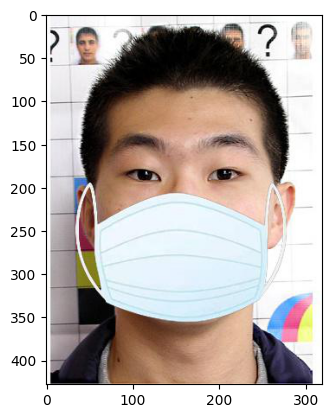

In [ ]:
img=mpimg.imread('/content/data/with_mask/with_mask_1600.jpg')
imgplot=plt.imshow(img)
plt.show()

In [ ]:
with_mask_path='/content/data/with_mask/'

data=[]

for img_file  in with_mask:
  image =Image.open(with_mask_path + img_file)
  image =image.resize((128,128))
  image =image.convert("RGB")
  image =np.array(image)
  data.append(image) 

without_mask_path='/content/data/without_mask/'

for img_file  in without_mask:
  image =Image.open( without_mask_path + img_file)
  image =image.resize((128,128))
  image =image.convert("RGB")
  image =np.array(image)
  data.append(image) 

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


In [ ]:
print(len(data))

7553


In [ ]:
X=np.array(data)
Y=np.array(labels)
print(X.shape)
print(Y.shape)

(7553, 128, 128, 3)
(7553,)


In [ ]:
X_train,X_test,Y_train,Y_test=train_test_split(X,Y, test_size=0.2, random_state=3)

print(X.shape,X_train.shape,X_test.shape)

(7553, 128, 128, 3) (6042, 128, 128, 3) (1511, 128, 128, 3)


In [ ]:
X_train_scaled= X_train/255
X_test_scaled= X_test/255

print(X_train_scaled[0])

[[[0.53333333 0.38431373 0.29411765]
  [0.5372549  0.38823529 0.29803922]
  [0.54117647 0.39215686 0.30196078]
  ...
  [0.65098039 0.49411765 0.40392157]
  [0.66666667 0.50588235 0.41176471]
  [0.69019608 0.5254902  0.42745098]]

 [[0.54901961 0.39215686 0.29803922]
  [0.55294118 0.39607843 0.30196078]
  [0.55686275 0.39607843 0.30588235]
  ...
  [0.64313725 0.4745098  0.37254902]
  [0.65098039 0.47843137 0.37647059]
  [0.66666667 0.49019608 0.38823529]]

 [[0.62745098 0.45882353 0.36078431]
  [0.63137255 0.4627451  0.36470588]
  [0.63529412 0.46666667 0.36862745]
  ...
  [0.63529412 0.45098039 0.3372549 ]
  [0.63529412 0.44705882 0.32941176]
  [0.64313725 0.45098039 0.3372549 ]]

 ...

 [[0.50196078 0.48627451 0.4627451 ]
  [0.49803922 0.48235294 0.4627451 ]
  [0.50588235 0.47843137 0.45098039]
  ...
  [0.88235294 0.87843137 0.90980392]
  [0.92156863 0.91764706 0.94901961]
  [0.94901961 0.94509804 0.97647059]]

 [[0.48627451 0.50588235 0.48627451]
  [0.49411765 0.50980392 0.49019608]


In [ ]:
import tensorflow as tf
from tensorflow import keras

In [ ]:
num_of_classes=2

model = keras.Sequential()

model.add(keras.layers.Convolution2D(32,kernel_size=(3,3),activation="relu",input_shape=(128,128,3)))
model.add(keras.layers.MaxPooling2D(pool_size=(2,2)))


model.add(keras.layers.Convolution2D(64,kernel_size=(3,3),activation="relu"))
model.add(keras.layers.MaxPooling2D(pool_size=(2,2)))

model.add(keras.layers.Convolution2D(128,kernel_size=(3,3),activation="relu"))
model.add(keras.layers.MaxPooling2D(pool_size=(2,2)))

model.add(keras.layers.Flatten())
model.add(keras.layers.Dense(128,activation="relu"))
model.add(keras.layers.Dropout(0.5))

model.add(keras.layers.Dense(64,activation="relu"))
model.add(keras.layers.Dropout(0.5))

model.add(keras.layers.Dense(32,activation="relu"))
model.add(keras.layers.Dropout(0.5))

model.add(keras.layers.Dense(1,activation="sigmoid"))

In [ ]:
model.compile(
    optimizer="sgd",
    loss = tf.keras.losses.BinaryCrossentropy(),
    metrics=['acc']
)

In [ ]:
history=model.fit(X_train_scaled,Y_train, validation_split=0.1, epochs=5)

Epoch 1/5
170/170 [==============================] - 16s 24ms/step - loss: 0.6951 - acc: 0.4977 - val_loss: 0.6900 - val_acc: 0.6298
Epoch 2/5
170/170 [==============================] - 4s 25ms/step - loss: 0.6902 - acc: 0.5315 - val_loss: 0.6819 - val_acc: 0.6876
Epoch 3/5
170/170 [==============================] - 3s 19ms/step - loss: 0.6736 - acc: 0.6029 - val_loss: 0.6329 - val_acc: 0.7967
Epoch 4/5
170/170 [==============================] - 3s 19ms/step - loss: 0.6117 - acc: 0.6853 - val_loss: 0.4779 - val_acc: 0.8430
Epoch 5/5
170/170 [==============================] - 3s 20ms/step - loss: 0.5103 - acc: 0.7723 - val_loss: 0.3564 - val_acc: 0.8562


In [ ]:
test_loss, acc = model.evaluate(X_test_scaled, Y_test)
print('\nTest Accuracy:', acc)
print('\nTest Loss:', test_loss)

48/48 [==============================] - 1s 11ms/step - loss: 0.3594 - acc: 0.8657

Test Accuracy: 0.8656519055366516

Test Loss: 0.35937055945396423


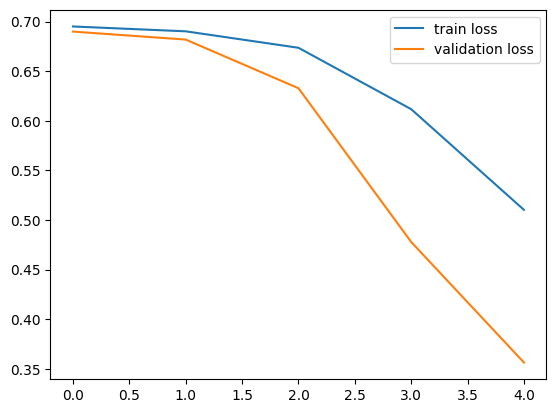

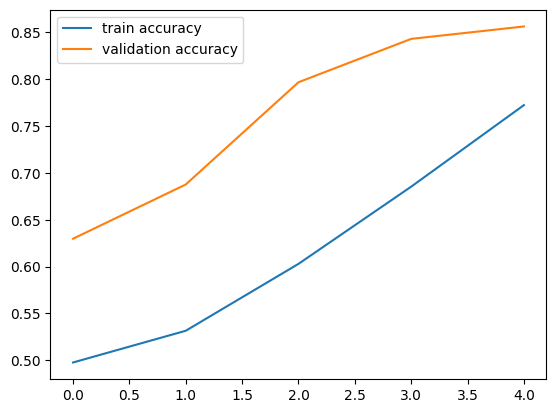

In [ ]:
h = history

plt.plot(h.history["loss"],label = "train loss")
plt.plot(h.history["val_loss"],label = "validation loss")
plt.legend()
plt.show()


plt.plot(h.history["acc"],label = "train accuracy")
plt.plot(h .history["val_acc"],label = "validation accuracy")
plt.legend()
plt.show()

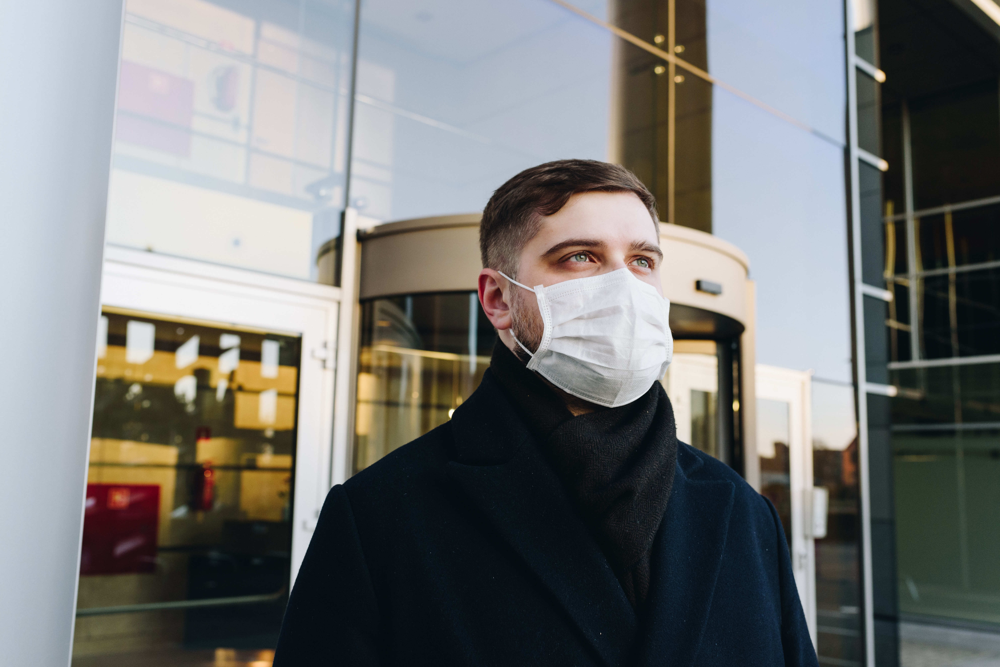

1/1 [==============================] - 1s 746ms/step
[[0.29372174 0.72874874]]
1
The person in the image is wearing a mask


In [ ]:
input_image_path=input("Image provided from the user: ")

input_image= cv2.imread(input_image_path)
cv2_imshow(input_image)
image_resize=cv2.resize(input_image,(128,128))
image_scaled=image_resize/255
image_reshaped=np.reshape(image_scaled,[1,128,128,3])
image_prediction=model.predict(image_reshaped)
print(image_prediction)
img_aug=np.argmax(image_prediction)
print(img_aug)


if img_aug == 1:

  print('The person in the image is wearing a mask')

else:

  print('The person in the image is not wearing a mask')